Name: Avani Gupta <br>
Roll : 2019121004

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import time

In [2]:
def display_img_arr(img_arr, r, c, dim,titles_arr):
    fl = 0
    fig = plt.figure(figsize = dim)
    for i in range(r):
        for j in range(c):
            if len(img_arr) == fl:
                break
            ax1 = fig.add_subplot(r, c, fl + 1)
            ax1.set_title(titles_arr[fl], fontsize = 20)
            ax1.imshow(img_arr[fl], cmap = 'gray')
            fl = fl + 1
    plt.show()

## Question 1
The implementation of linear spatial filters requires moving a mask cen-tered at each pixel of the image, computing sum of products of mask coefficients and
corresponding pixels.
1. Implement an algorithm for low-pass filtering a grayscale image by moving a k × k
averaging filter of the form ones((k,k))/(k^2 ).


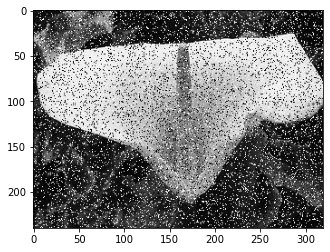

In [3]:
path = "../images/"
I = cv2.imread(path+'Noisy.jpg',cv2.IMREAD_GRAYSCALE)  
plt.gray()
plt.imshow(I)

In [4]:
def lowPassAvg(img, k):
    tic = time.time()
    img2 = np.zeros(img.shape)
    num = int(k/2)
    fil = np.ones((k,k))
    divk2 = 1/k*k
    for i in range(num , img.shape[0] - num):
        for j in range(num , img.shape[1] - num):
            for f in range(i - num , i + num + 1):   # eq to moving the filter of ones*1/(k^2)
                for l in range(j - num , j + num + 1):
                    img2[i][j] = (img2[i][j] + img[f][l]*divk2)
    tac = time.time()
    return img2,tac-tic

time taken 2.74202299118042


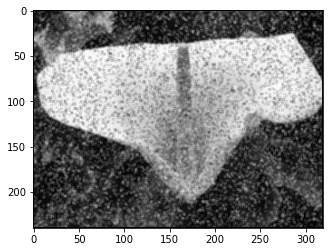

In [5]:
If,ti = lowPassAvg(I,3)
plt.gray()
plt.imshow(If)
print("time taken",ti)

2. As the filter is moved from one spatial location to the next one, the filter window
shares many common pixels in adjacent neighborhoods. Exploit this observation
and implement a more efficient version of averaging filter.

In [6]:
def efficientLowPassAvg(img,k):
    start = time.time()
    filterr = np.ones((k,k))
    filterr /= (k**2)
    rows, cols = img.shape[:2]
    padding = int((k-1)/2)

    img = cv2.copyMakeBorder(img, padding, padding, padding, padding, cv2.BORDER_REPLICATE)
    output = np.zeros(img.shape, dtype="float32")
    yarr = np.arange(padding, rows + padding)
    xarr = np.arange(padding, cols + padding)
    for y in yarr:
        for x in xarr:
            output[y-padding, x-padding] = (img[y - padding: padding + y + 1, x - padding:padding + x + 1] * filterr).sum()
    
    output = cv2.normalize(output, 0, 255, cv2.NORM_MINMAX)
    end = time.time()
    t = end - start
    return output,t

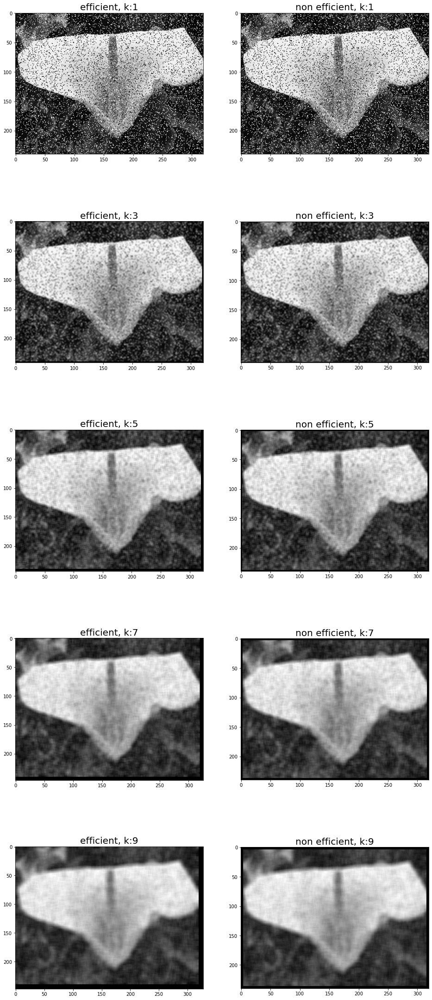

In [7]:
images = []
tit = []
efficient_time = []
noneff_time = []
img = cv2.imread(path+'Noisy.jpg',cv2.IMREAD_GRAYSCALE)  

for i in range(1,10,2):
    im1,t1 = efficientLowPassAvg(img.astype(np.float64),i)
    efficient_time.append(t1)
    images.append(im1)
    tit.append("efficient, k:"+str(i))

    im2,t2 = lowPassAvg(img.astype(np.float64),i)
    images.append(im2)
    tit.append("non efficient, k:"+str(i))
    noneff_time.append(t2)
display_img_arr(images, 5,2,(16,40), tit)

3. To appreciate the benefits of doing so, generate a plot of k vs run-time for various
sized images. The plot diagram should contain a line plot for each image size
you pick. Use different marker types to distinguish the default implementation
and improved implementation. Just to give you a rough idea, look at https:
//imgur.com/a/0HtYlTE.

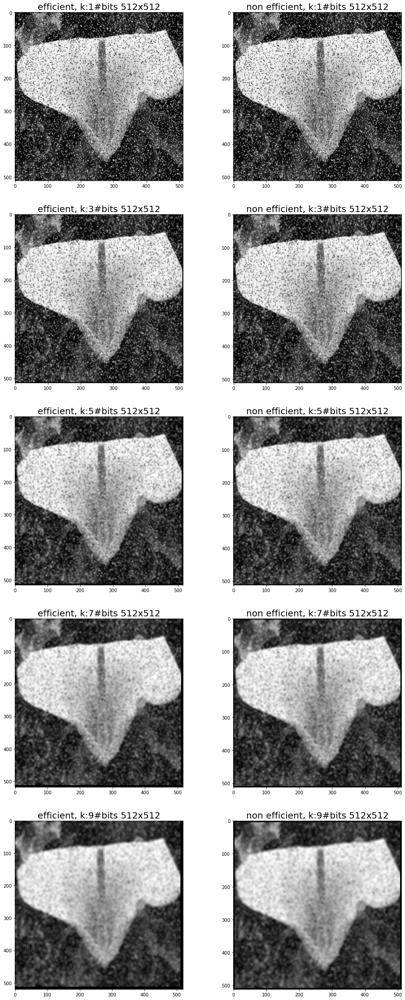

In [8]:
im = cv2.imread(path+'Noisy.jpg',cv2.IMREAD_GRAYSCALE)  

# efficient_time = []
# noneff_time = []
# img = []
# tit = []
def func(im,s):
    images = []
    tit = []
    efficient_time = []
    noneff_time = []
    for i in range(1,10,2):
        img = cv2.resize(im, (s,s))
        im1,t1 = efficientLowPassAvg(img.astype(np.float64),i)
        efficient_time.append(t1)
        images.append(im1)
        tit.append("efficient, k:"+str(i)+"#bits "+str(s)+"x"+str(s))

        im2,t2 = lowPassAvg(img.astype(np.float64),i)
        images.append(im2)
        tit.append("non efficient, k:"+str(i)+"#bits "+str(s)+"x"+str(s))
        noneff_time.append(t2)
    return efficient_time,noneff_time, images,tit
    
size = [64,128,256]


eff_time1,noneff_time1, img,tit = func(im,128)
eff_time2,noneff_time2, img,tit = func(im,256)
eff_time3,noneff_time3, img,tit = func(im,512)

#display images for 512x512
display_img_arr(img, 5,2,(16,40), tit)

    


In [9]:
def plotTime(x,efficient,noneff,size):
    fig = plt.figure()
    plt.xlabel('k')
    plt.ylabel('time')
    x = np.array(x).reshape(len(x),1)
    efficient = np.array(efficient)
    noneff = np.array(noneff)

#     y1 = np.array(efficient[0])
#     y2 = np.array(noneff[0])
#     plt.plot(x,y1,'r--',label='efficient'+str(size[0])+"x"+str(size[0]))
#     plt.plot(x,y2,'g--',label='non efficient'+str(size[0])+"x"+str(size[0]))
    
    y1 = np.array(efficient[1])
    y2 = np.array(noneff[1])
    plt.plot(x,y1,'r--',label='efficient'+str(size[1])+"x"+str(size[1]))
    plt.plot(x,y2,'g--',label='non efficient'+str(size[1])+"x"+str(size[1]))
    
    
    y1 = np.array(efficient[2])
    y2 = np.array(noneff[2])
    plt.plot(x,y1,'r',label='efficient'+str(size[2])+"x"+str(size[2]))
    plt.plot(x,y2,'g',label='non efficient'+str(size[2])+"x"+str(size[2]))
    
    plt.legend()
    plt.show()
                            

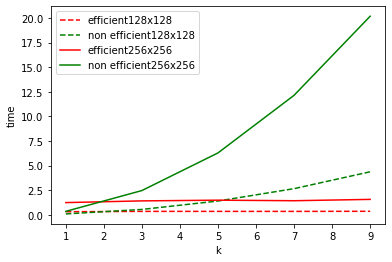

In [10]:
efficient = np.stack([eff_time1,eff_time2,eff_time3])
noneff = np.stack([noneff_time1,noneff_time2,noneff_time3])

x = range(1,10,2)
plotTime(x,efficient,noneff,size)

4. Utilize the observation similar to above to implement an efficient version of a k × k
median filter. Generate a plot figure similar to previous question.
5. Using the denoising concepts discussed in the class, try to remove noise from
Noisy.jpg

In [11]:
def med(im,k):
    tic = time.time()
    num = int(k/2)
    newimg = np.zeros((im.shape))
   
    for i in range(im.shape[0]):
        for j in range(im.shape[1]):
            arr = []
            for m in range(k):
                r1 = i + m -num
                if(r1 < 0) or (r1>im.shape[0]-1):
                    for p in range(k):
                        arr.append(0)
                
                else:
                    r2 = j+m-num
                    if(r2<0) or ((j+num)>(im.shape[1]-1)):
                        arr.append(0)
                    else:
                        for q in range(k):
                            arr.append(im[r1][j+q-num])
                            
            arr.sort()
            medind = int(len(arr)/2)
            median = arr[medind]
            newimg[i][j] = median
           
    
    tac = time.time()
    return newimg,tac-tic
                    

In [12]:
def medEff(im,k):
    tic = time.time()
    sub = np.subtract(im.shape,(k,k))
    strd = np.lib.stride_tricks.as_strided
    subM = strd(im, shape=tuple(sub)+(k,k), strides=im.strides*2)
    newimg = np.median(subM,axis=(2,3))
    tac = time.time()
    return newimg,tac-tic

In [13]:
im = cv2.imread(path+'Noisy.jpg',cv2.IMREAD_GRAYSCALE)  
medImg,time1 = med(im,5)

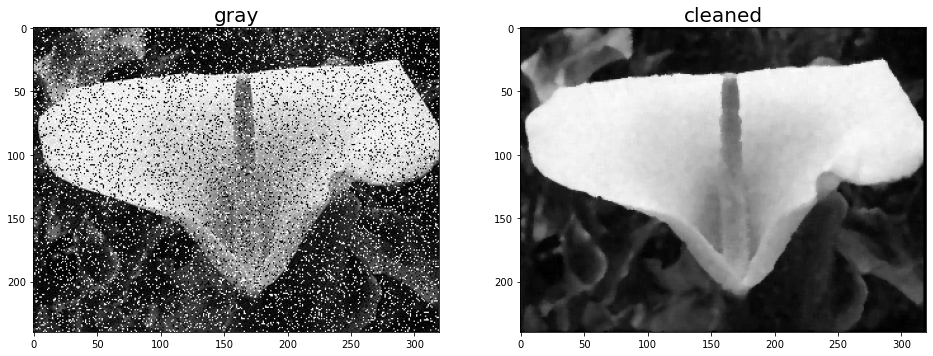

In [14]:
img = []
tit = []
img.append(im)
tit.append('gray')
img.append(medImg)
tit.append('cleaned')
display_img_arr(img, 1,2,(16,20), tit)

In [15]:
time_eff = []
time_noneff = []
img = []
tit = []
im = cv2.imread(path+'Noisy.jpg',cv2.IMREAD_GRAYSCALE)  
for i in range(1,21,4):
    im1,t1 = med(im,i)
    img.append(im1)
    tit.append('non eff, k:'+str(i))
    time_noneff.append(t1)
    im2,t2 = medEff(im,i)
    img.append(im2)
    tit.append('eff, k:'+str(i))
    time_eff.append(t2)


In [16]:
img[0].shape

(240, 320)

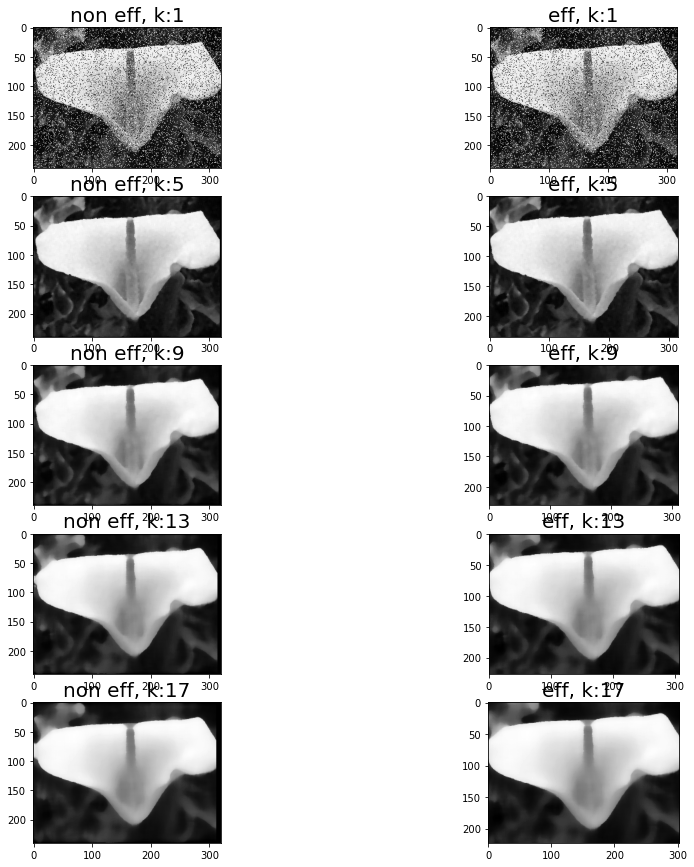

In [17]:
display_img_arr(img, 5, 2, (15, 15), tit)

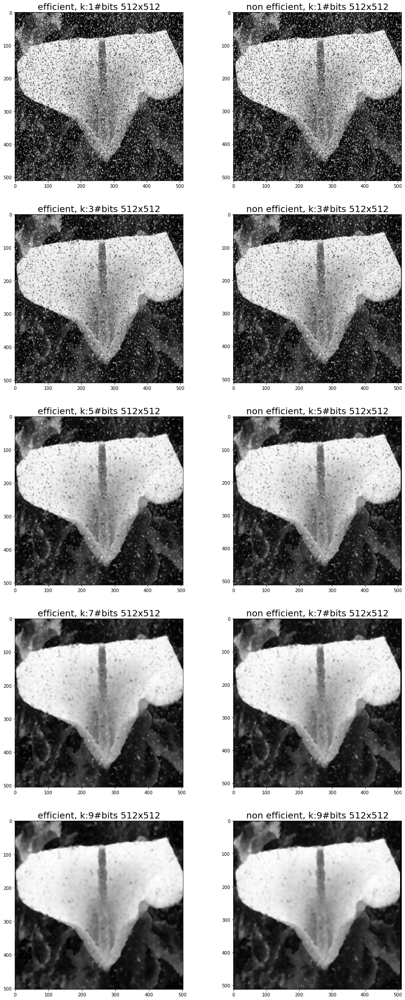

In [18]:

im = cv2.imread(path+'Noisy.jpg',cv2.IMREAD_GRAYSCALE)  

# efficient_time = []
# noneff_time = []
# img = []
# tit = []
def func(im,s):
    images = []
    tit = []
    efficient_time = []
    noneff_time = []
    for i in range(1,10,2):
        img = cv2.resize(im, (s,s))
        im1,t1 = medEff(img.astype(np.float64),i)
        efficient_time.append(t1)
        images.append(im1)
        tit.append("efficient, k:"+str(i)+"#bits "+str(s)+"x"+str(s))

        im2,t2 = med(img.astype(np.float64),i)
        images.append(im2)
        tit.append("non efficient, k:"+str(i)+"#bits "+str(s)+"x"+str(s))
        noneff_time.append(t2)
    return efficient_time,noneff_time, images,tit
    
size = [64,128,256]


eff_time1,noneff_time1, img,tit = func(im,128)
eff_time2,noneff_time2, img,tit = func(im,256)
eff_time3,noneff_time3, img,tit = func(im,512)

#display images for 512x512
display_img_arr(img, 5,2,(16,40), tit)

    

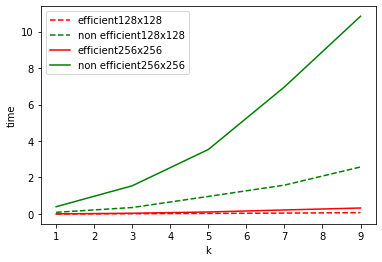

In [19]:
# median runtimes
efficient = np.stack([eff_time1,eff_time2,eff_time3])
noneff = np.stack([noneff_time1,noneff_time2,noneff_time3])

x = range(1,10,2)
plotTime(x,efficient,noneff,size)

## Question 2 Edge Detection
1) Read about Canny Edge detector. Apply the Canny edge detector (use inbuilt
cv2.Canny function for this task) to bell.jpg.


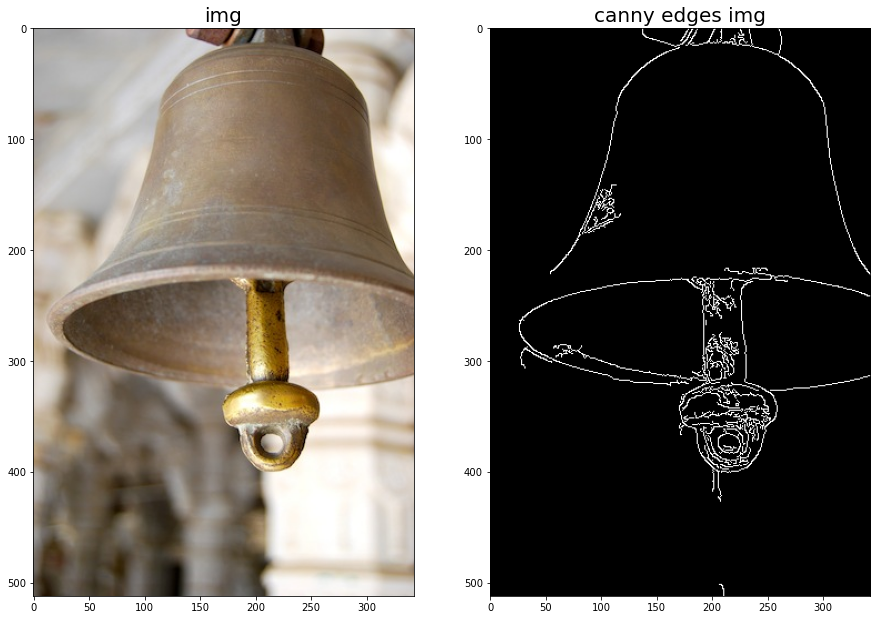

In [20]:
bell = cv2.imread(path+"bell.jpg")

bell_edge = cv2.Canny(bell,350,5)
bell = cv2.cvtColor(bell, cv2.COLOR_BGR2RGB)
display_img_arr([bell,bell_edge],1,2,(15,15),['img','canny edges img'])

2) Tweak the values of the arguments (minVal and maxVal ), and report the values
that give the best results for each image. (Hint: Try to detect as many edges in
the bell as possible, while avoiding edges in the background.).

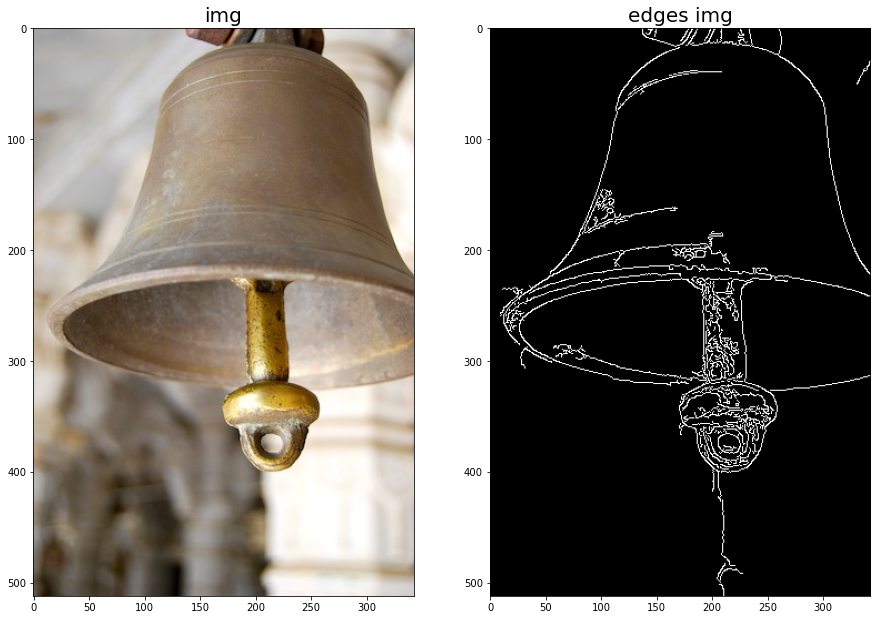

In [21]:
bell_edge = cv2.Canny(bell,250,10)
display_img_arr([bell,bell_edge],1,2,(15,15),['img','edges img'])

thus for threshold of 250,10 in canny edge the value comes to be good

3)Consider Roberts, Prewitt, Sobel and Laplacian filters discussed in the class.
Implement and apply these filters on kobe.png and make observations upon com-
paring their outputs. Compare these with the output of Canny edge detector on
the same image.

In [9]:
def convolve(im, k):
    im = im.astype(np.float64)
    k = k.astype(np.float64)
    res = np.zeros(im.shape)
    rows = int(k.shape[0]/ 2)
    cols = im.shape[0] - int((k.shape[0]-1) / 2)
    cols2 = im.shape[1] - int((k.shape[1] - 1) / 2)
    for i in range(rows, cols):
        for j in range(int(k.shape[1]/ 2),cols2):
            res[i][j] = max(0, sum(sum(k * im[i - rows : i + int((k.shape[0] - 1) / 2) + 1, j - int(k.shape[1] / 2) : j + int((k.shape[1] - 1) / 2) + 1])))
    return res.astype(np.int)

In [10]:
img = cv2.imread(path+"kobe.png",0)

In [11]:
# filters
def prewitt(img):
    filterx = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]) 
    filtery = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]]) 
    cx = convolve(img, filterx).astype(np.float64)
    cy = convolve(img, filtery).astype(np.float64)
    output = np.sqrt(cx * cx + cy * cy).astype(np.uint8)
    return cx+128,cy+128,output

def sobel(img):
    filterx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]]) 
    filtery = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]]) 
    cx = convolve(img, filterx).astype(np.float64)
    cy = convolve(img, filtery).astype(np.float64)
    output = np.sqrt(cx * cx + cy * cy).astype(np.uint8)
    return cx,cy,output
  
def roberts(img):
    filterx = np.array([[0, 1], [-1, 0]]) 
    filtery = np.array([[1, 0], [0, -1]]) 
    cx = convolve(img, filterx).astype(np.float64)
    cy = convolve(img, filtery).astype(np.float64)
    output = np.sqrt(cx * cx + cy * cy).astype(np.uint8)
    return cx,cy,output

def laplacian(img):
    filter1 = np.array([[0, 1, 0], [1, -4, 1], [0, 1, 0]]) 
    filter2 = np.array([[1, 1, 1], [1, -8, 1], [1, 1, 1]]) 
    c1 = convolve(img, filter1)
    c2 = convolve(img, filter2)
    return c1+128,c2+128
    


In [12]:
def appendOuts(cx,cy,c,images,titles,filtername):
    images.append(cx)
    titles.append(filtername+" X")
    images.append(cy)
    titles.append(filtername+" Y")
    images.append(c)
    titles.append(filtername)
    return titles, images

In [14]:

titles = []
images = []
titles.append("original img")
images.append(img)
cx,cy,c = prewitt(img)
titles, images = appendOuts(cx,cy,c,images,titles,"prewitt")

# cx,cy,c = sobel(img)
# titles, images = appendOuts(cx,cy,c,images,titles,"sobel")

# cx,cy,c = roberts(img)
# titles, images = appendOuts(cx,cy,c,images,titles,"roberts")
# c1,c2 = laplacian(img)
# images.append(c1)
# titles.append('Laplacian(-4 in center)')
# images.append(c2)
# titles.append('Laplacian(-8 in center)')

# images.append(cv2.Canny(img, 100, 250))
# titles.append('Canny Edge Detector')


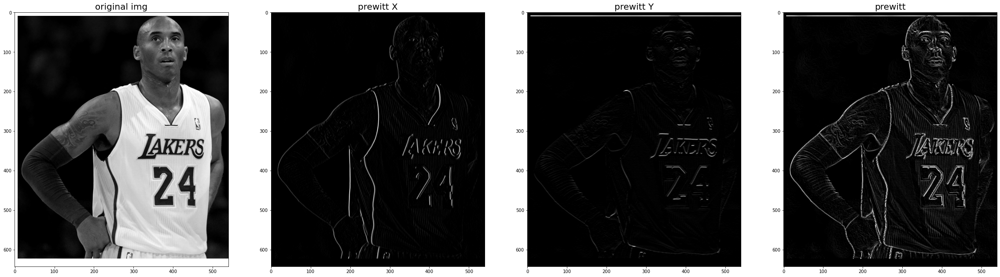

In [15]:
display_img_arr(images, 1, 4, (40, 40), titles)

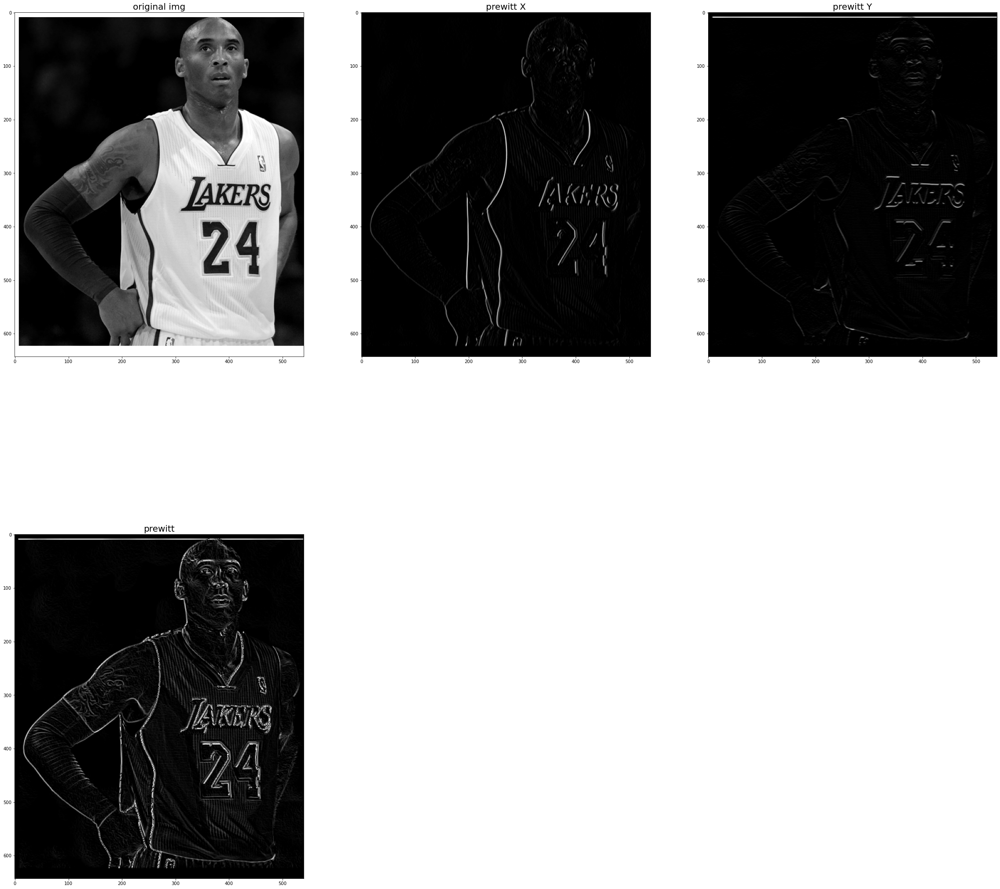

In [17]:
display_img_arr(images, 2,3, (40, 40), titles)

Laplacian Filter and Canny Edge Detector completely fails when noise is added. Sobel and Prewitt does a pretty good job in detecting edges even in noise corrupted image. Roberts also does a decent job!

4. What will the 5×5 variants of Sobel and Prewitt filters look like? Apply these
larger filters on kobe.png and make observations upon comparing their outputs
with the corresponding smaller filters.


In [28]:
def prewitt5(img):
    filterx = np.array([[-2,-1, 0, 1,2], [-2,-1, 0, 1,2], [-2,-1, 0, 1,2], [-2,-1, 0, 1,2], [-2,-1, 0, 1,2]]) 
    filtery = np.array([[2,2,2,2,2],[1,1,1, 1, 1], [0,0,0, 0, 0], [-1,-1,-1, -1, -1],[-2,-2,-2,-2,-2]]) 
    cx = convolve(img, filterx).astype(np.float64)
    cy = convolve(img, filtery).astype(np.float64)
    output = np.sqrt(cx * cx + cy * cy).astype(np.uint8)
    return cx+128,cy+128,output

In [29]:
def sobel5(img):
    filterx = np.array([[-5,-4, 0, 4,5], [-8,-10, 0,10, 8], [-10, -20,0,20,10],[-8,-10, 0,10, 8],[-5,-4, 0, 4,5]]) 
    filtery = np.array([[-5, -8,-10,-8,-5],[-4,-10,-20,-10,-4],[0,0,0, 0, 0], [4,10,20,10,4],[5, 8,10,8,5]]) 
    cx = convolve(img, filterx).astype(np.float64)
    cy = convolve(img, filtery).astype(np.float64)
    output = np.sqrt(cx * cx + cy * cy).astype(np.uint8)
    return cx,cy,output
  

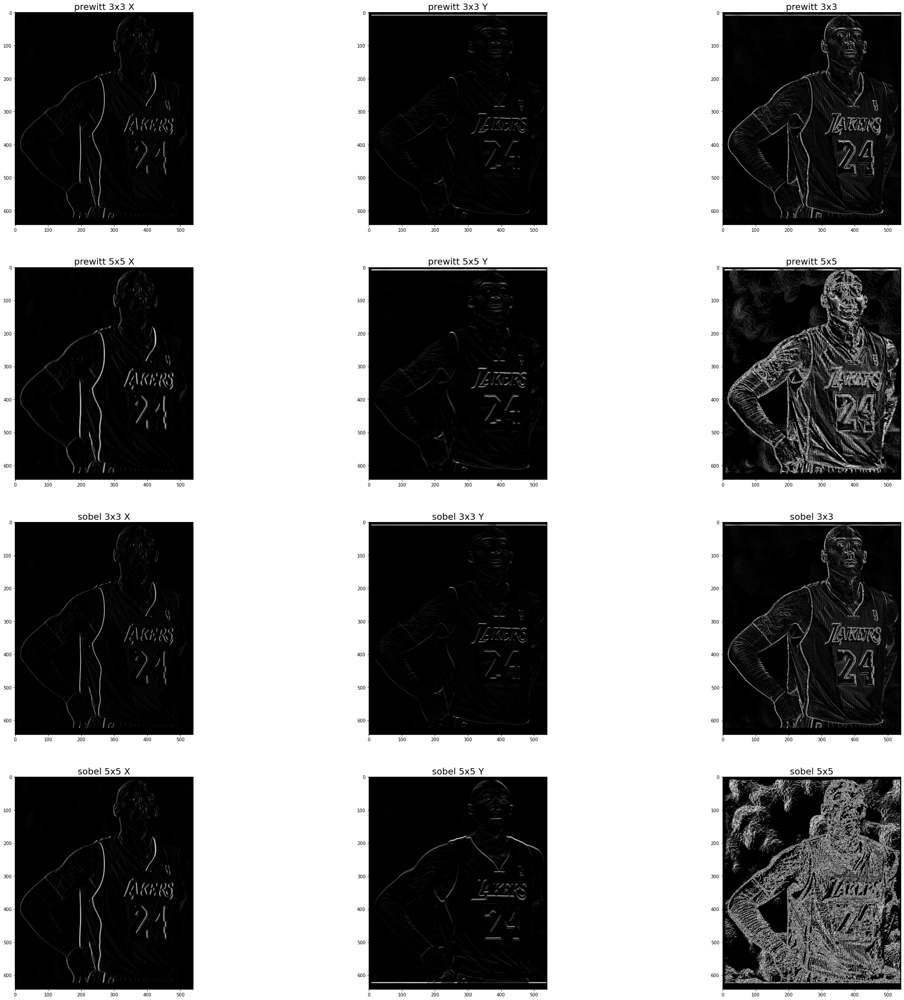

In [30]:
images = []
titles = []
img = cv2.imread(path+"kobe.png",0)

cx,cy,c = prewitt(img)
titles, images = appendOuts(cx,cy,c,images,titles,"prewitt 3x3")
cx,cy,c = prewitt5(img)
titles, images = appendOuts(cx,cy,c,images,titles,"prewitt 5x5")
cx,cy,c = sobel(img)
titles, images = appendOuts(cx,cy,c,images,titles,"sobel 3x3")
cx,cy,c = sobel5(img)
titles, images = appendOuts(cx,cy,c,images,titles,"sobel 5x5")
display_img_arr(images, 4, 3, (40, 40), titles)

As we see 5x5 variants capture in more edges as compared to 3x3 variants. 
Sobel 5x5's output gets too noisy and it captures all small edges too.
Prewit 5x5 is better compared to Sobel 5x5 though both capture a lot of edges making the output look noisy.
Coming to Prewit 3x3 and sobel 3x3, they are pretty descent and capture required edges better than the 5x5 ones.


5. Add noise to the input image above using Gaussian sampling. Study the effect of
applying the above filters(from 2 nd part) on noise-affected inputs.

In [31]:
def addNoise(image,mean,sigma):
    image = image.astype(np.float64)
    gauss = np.random.normal(mean,sigma,(image.shape[0],image.shape[1]))
    gauss = gauss.reshape(image.shape[0],image.shape[1])
    noisy = image + gauss
    return noisy

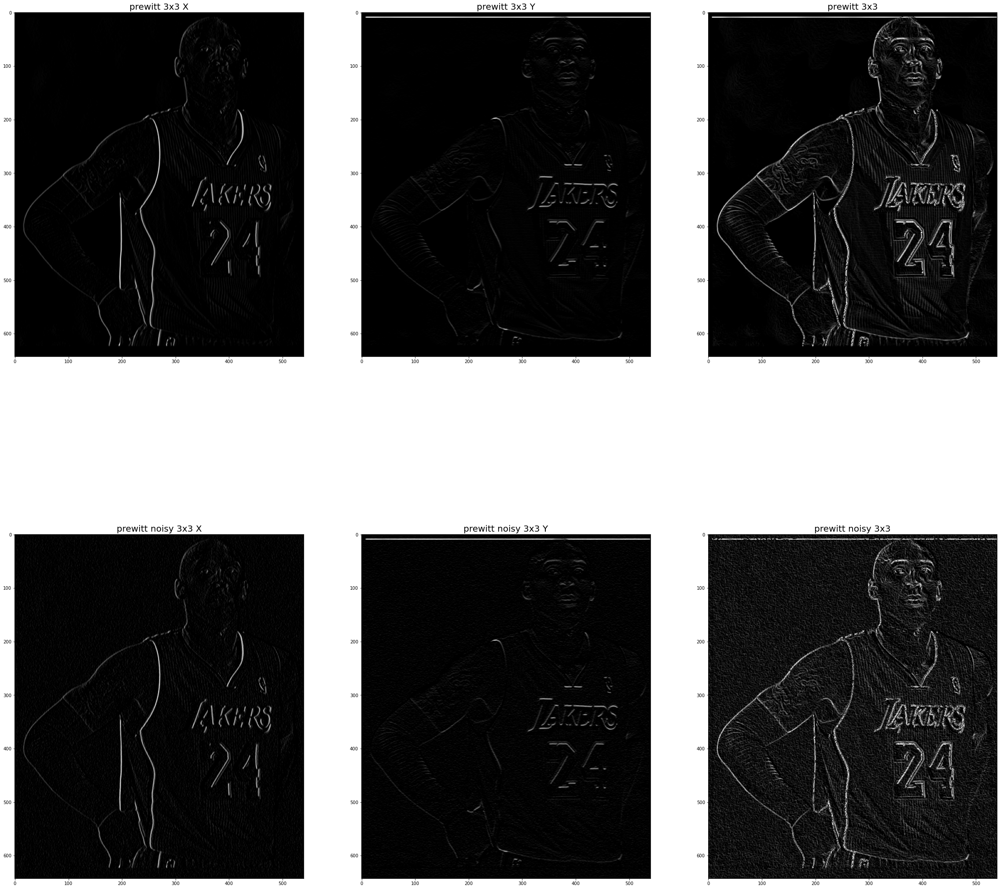

In [32]:
images = []
titles = []
img = cv2.imread(path+"kobe.png",0)
img_n = addNoise(img,0,10)
cx,cy,c = prewitt(img)
titles, images = appendOuts(cx,cy,c,images,titles,"prewitt 3x3")
cx,cy,c = prewitt(img_n)
titles, images = appendOuts(cx,cy,c,images,titles,"prewitt noisy 3x3")
display_img_arr(images, 2, 3, (40, 40), titles)


In [33]:
images = []
titles = []
img = cv2.imread(path+"kobe.png",0)
img_n = addNoise(img,0,10)
cx,cy,c = prewitt(img)
images.append(c)
titles.append("previtt")
cx,cy,c = prewitt(img_n)
images.append(c)
titles.append("previtt noisy")

cx,cy,c = sobel(img)
images.append(c)
titles.append("sobel")
cx,cy,c = sobel(img_n)
images.append(c)
titles.append("sobel noisy")

cx,cy,c = roberts(img)
images.append(c)
titles.append("roberts")
cx,cy,c = roberts(img_n)
images.append(c)
titles.append("roberts noisy")

c1,c2 = laplacian(img)
images.append(c1)
titles.append('Laplacian(-4 in center)')
images.append(c2)
titles.append('Laplacian(-8 in center)')

c1,c2 = laplacian(img_n)
images.append(c1)
titles.append('Laplacian(-4 in center) noisy')
images.append(c2)
titles.append('Laplacian(-8 in center) noisy')

images.append(cv2.Canny(img_n.astype('uint8'), 100, 250))
titles.append('Canny Edge Detector')

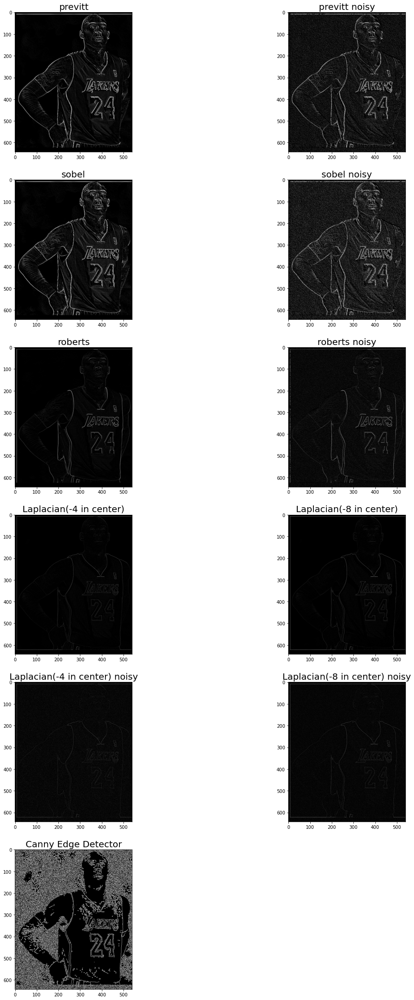

In [34]:
display_img_arr(images, 6, 2, (20, 40), titles)

In [35]:
images = []
titles = []
cx,cy,c = prewitt5(img)
images.append(c)
titles.append("previtt 5x5")
cx,cy,c = prewitt5(img_n)
images.append(c)
titles.append("previtt 5x5 noisy")

cx,cy,c = sobel5(img)
images.append(c)
titles.append("sobel 5x5")
cx,cy,c = sobel5(img_n)
images.append(c)
titles.append("sobel 5x5 noisy")


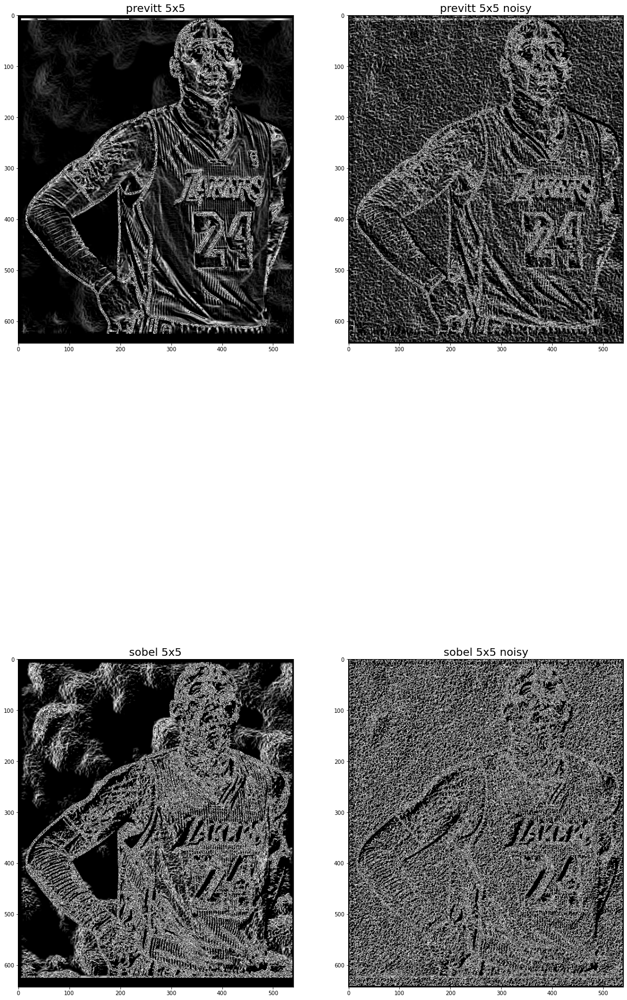

In [36]:
display_img_arr(images, 2, 2, (20, 40), titles)

As we see, 3x3 filters of Prewitt, Sobel, Roberts, Laplacians all do pretty decent whereas their 5x5 equivalent's fail and canny to detect edges completely capturing entire noise.
Amongst 3x3, prewit and sobel fail to some extent, Roberts does ok but all three are affected by noise, whereas Laplacian is least affected by noise and gives a similar output to that without noise.



## Question 3 Bilateral Filtering
1. Implement Bilateral Filtering and apply it on mountain.jpg

In [37]:
def bilateral_filter(img, sigma_d, sigma_r, ks):
    img = img.astype(np.float64)
    gaussian_kernel = np.zeros((ks, ks))
    res = np.zeros(img.shape)
    ks_h = int(ks/2)
    for i in range(ks):
        for j in range(ks):
                den = 2 * sigma_d * sigma_d
                num = -(((i - ks_h) * (i - ks_h)) + ((j - ks_h) * (j - ks_h)))
                gaussian_kernel[i][j] = np.exp(num)/den 
    for i in range(ks_h, img.shape[0] - ks_h):
        for j in range(ks_h, img.shape[1] - ks_h):
            for k in range(3):
                block = img[i - ks_h : i + ks_h + 1, j - ks_h : j + ks_h + 1, k : k + 1]
                block = block.reshape(ks, -1)
                ker_range = img[i - ks_h : i + ks_h + 1, j - ks_h : j + ks_h + 1, k : k + 1]
                ker_range = ker_range.reshape(ks, -1)- img[i][j][k]
                ker_range *= ker_range
                ker_range /= (2 * sigma_r * sigma_r)
                kernel = gaussian_kernel * np.exp(-ker_range)
                res[i][j][k] = (sum(sum(block * kernel))) / sum(sum(kernel))
    return res.astype('uint8')

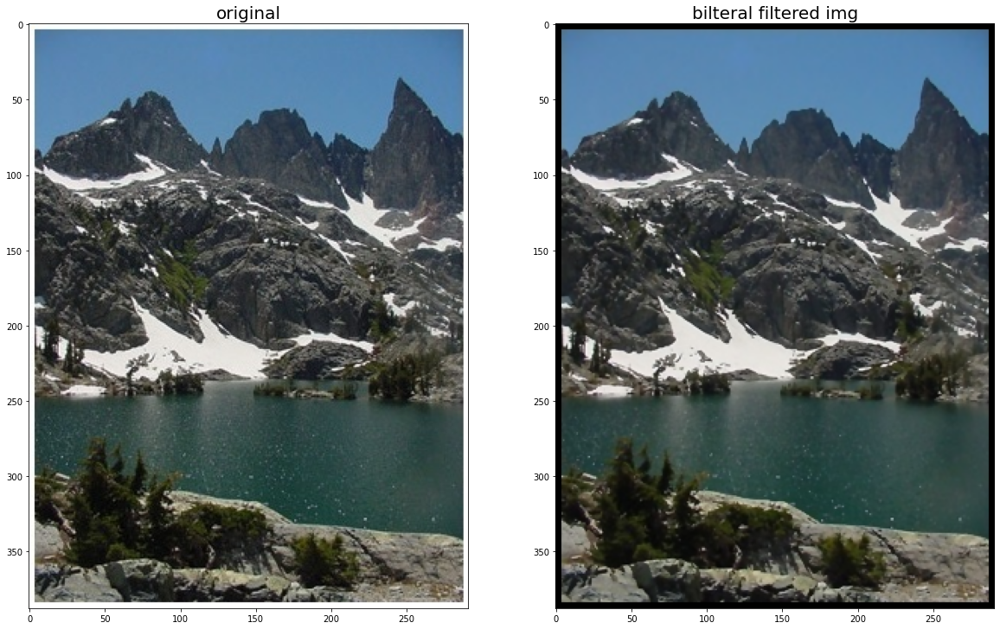

In [38]:
img = cv2.cvtColor(cv2.imread(path+'mountain.jpg'), cv2.COLOR_BGR2RGB)
output = bilateral_filter(img, 25, 25, 9)
display_img_arr([img,output], 1, 2, (20, 20), ['original','bilteral filtered img'])

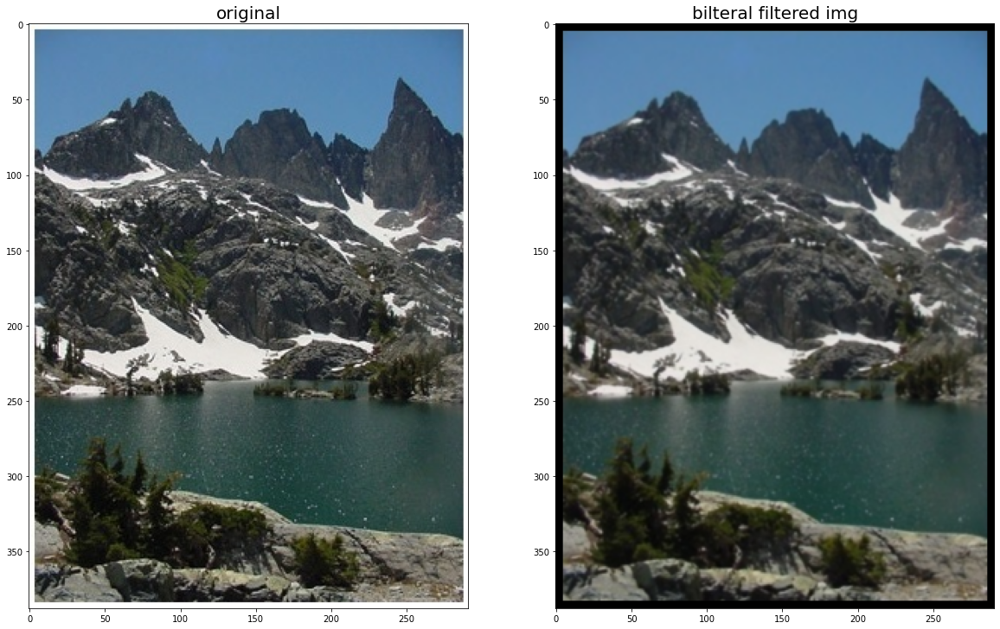

In [39]:
img = cv2.cvtColor(cv2.imread(path+'mountain.jpg'), cv2.COLOR_BGR2RGB)
output = bilateral_filter(img, 1000, 200, 11)
display_img_arr([img,output], 1, 2, (20, 20), ['original','bilteral filtered img'])

2. In low light imaging, images tend to be noisy and lose sharp edges. However, with
flash, there is an unpleasant direct-lighting effect. Here, a cross bilateral filter
can be used with the range and spatial filters acting on two different images.
3. By combining a flash photograph cake-flash.jpg and a no-flash photograph cake-
noflash.jpg, render a new photograph cake-out.jpg that has both the warm light-
ing of the no-flash picture and the crisp details of the flash image.

In [40]:
def crossbilateral_filter( img,img_flash,sigma_d, sigma_r, ks):
    img = img.astype(np.float64)
    gaussian_kernel = np.zeros((ks, ks))
    res = np.zeros(img.shape)
    ks_h = int(ks/2)
    for i in range(ks):
        for j in range(ks):
                den = 2 * sigma_d * sigma_d
                num = -(((i - ks_h) * (i - ks_h)) + ((j - ks_h) * (j - ks_h)))
                gaussian_kernel[i][j] = np.exp(num) / den 
    for i in range(ks_h, img.shape[0] - ks_h):
        for j in range(ks_h, img.shape[1] - ks_h):
            for k in range(3):
                block = img[i - ks_h : i + ks_h + 1, j - ks_h : j + ks_h + 1, k : k + 1]
                block = block.reshape(ks, -1)
                ker_range = img_flash[i - ks_h : i + ks_h + 1, j - ks_h : j + ks_h + 1, k : k + 1]
                ker_range = ker_range.reshape(ks, -1)- img[i][j][k]
                ker_range *= ker_range
                ker_range /= (2 * sigma_r * sigma_r)
                kernel = gaussian_kernel * ker_range
                res[i][j][k] = (sum(sum(block * kernel))) / sum(sum(kernel))
    return res.astype('uint8')

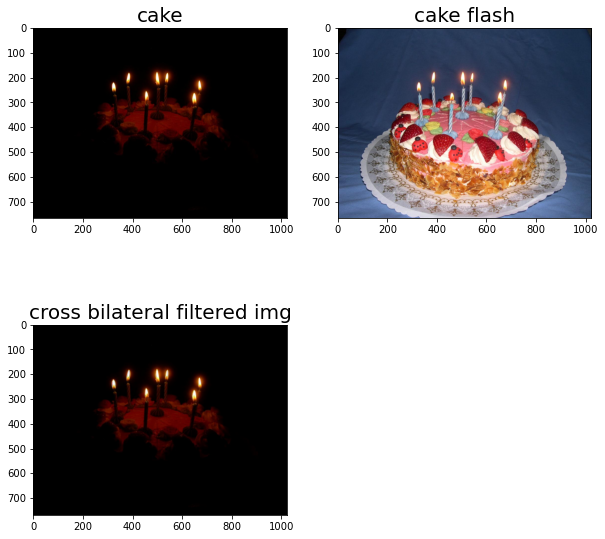

In [41]:
path = '../images/'
img = cv2.cvtColor(cv2.imread(path+'cake_noflash.jpg'), cv2.COLOR_BGR2RGB)
img_flash = cv2.cvtColor(cv2.imread(path+'cake_flash.jpg'), cv2.COLOR_BGR2RGB)
output = crossbilateral_filter(img, img_flash, 2000, 200, 11)
display_img_arr([img,img_flash,output], 2, 2, (10, 10), ["cake","cake flash","cross bilateral filtered img"])

We get the image similar to cake no flash as output of cross bilarater filter. 

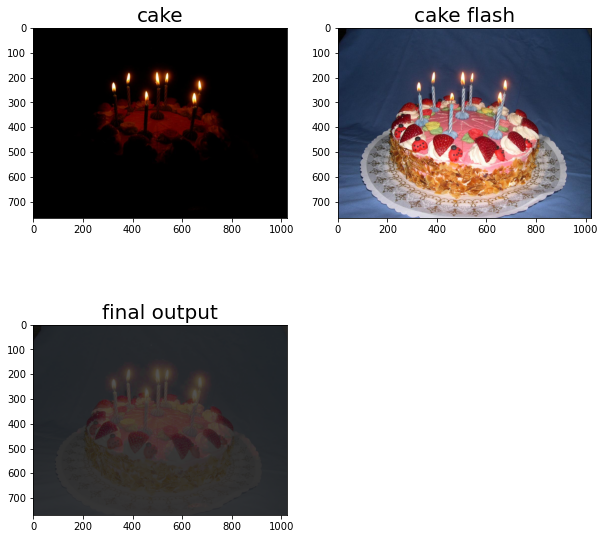

In [42]:
logxbil = np.log(output+np.ones(output.shape))
logflash = np.log(img_flash+3*np.ones(output.shape))
# out = np.multiply(logxbil,logflash).astype('uint8')
out = (5*logxbil+10*logflash).astype('uint8')
display_img_arr([img,img_flash,out], 2, 2, (10, 10), ["cake","cake flash","final output"])

## Question 4 
In order to achieve a basic cartoon effect, all you need is essentially - a bi-
lateral filter and some edge detection. The bilateral filter will reduce the color palette,
necessary for the cartoon look, and edge detection will allow production of bold silhou-
ettes. To get cartoonized effects following steps are needed -
1. Apply the bilateral filtering to the color image. Keep this filtered image aside for
the last step.
2. Now, take a copy of original color image, convert it to gray scale.
3. Apply blurring on this gray scale image to reduce noise. (Try different variants
of blurring and see the performance)
4. Now, create an edge mask from this blurred, gray scale image. An edge mask
can be obtained using adaptive thresholding.
5. Combine the bilateral filtered image from step 1 with edge mask(by taking bitwise
AND of both at each pixel location).

In [43]:
def bilateral_filter_gray(img, sigma_d, sigma_r, ks):
    img = img.astype(np.float64)
    gaussian_kernel = np.zeros((ks, ks))
    res = np.zeros(img.shape)
    ks_h = int(ks/2)
    for i in range(ks):
        for j in range(ks):
                gaussian_kernel[i][j] = np.exp(-(((i - ks_h) * (i - ks_h)) + ((j - ks_h) * (j - ks_h)) ) / (2 * sigma_d * sigma_d))
    for i in range(ks_h, img.shape[0] - ks_h):
        for j in range(ks_h, img.shape[1] - ks_h):
            block = img[i - ks_h : i + ks_h + 1, j - ks_h : j + ks_h + 1]
            block = block.reshape(ks, -1)
            ker_range = img[i - ks_h : i + ks_h + 1, j - ks_h : j + ks_h + 1]
            ker_range = ker_range.reshape(ks, -1)- img[i][j]
            ker_range *= ker_range
            ker_range /= (2 * sigma_r * sigma_r)
            kernel = gaussian_kernel * np.exp(-ker_range)
            res[i][j] = (sum(sum(block * kernel))) / sum(sum(kernel))
    
    return res.astype('uint8')

In [44]:
def medEff(im,k):
    tic = time.time()
    newimg = im
    for i in range(k,im.shape[0]-k):
        for j in range(k,im.shape[1]-k):
            newimg[i][j] = int(np.median(im[i-k:i+k+1,j-k:j+k+1]))
    
    tac = time.time()
    return newimg,tac-tic

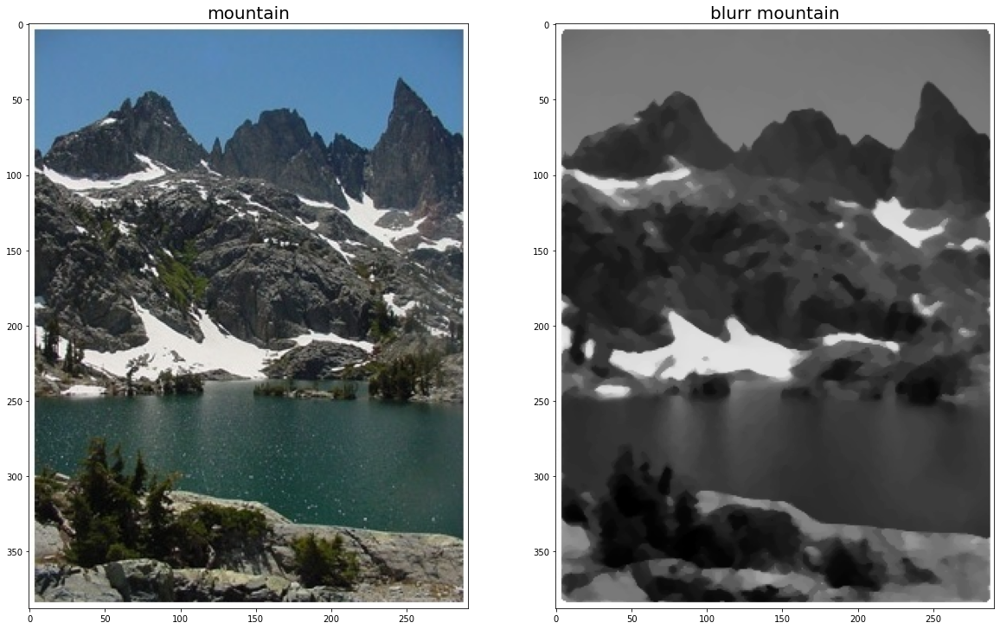

In [45]:
images = []
titles = []
img = cv2.cvtColor(cv2.imread(path+'mountain.jpg'), cv2.COLOR_BGR2RGB)
img_g = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
img_blurr ,_ =  medEff(img_g,2)
display_img_arr([img,img_blurr], 1, 2, (20, 20),  ['mountain','blurr mountain'])

In [46]:
def CustomAdaptiveThreshold(img, b, c):
    b_half = int(np.floor(b/2))
#     img= cv2.copyMakeBorder( img_blurr, b_half, b_half, b_half, b_half,cv2.BORDER_CONSTANT)
    new_img = np.zeros(img.shape)
    row_m = img.shape[0] - b_half
    col_m = img.shape[1] - b_half
    for i in range(b_half, row_m):
        for j in range(b_half, col_m ):
            th =  np.mean((img[i-b_half:i+b_half+1, j-b_half:j+b_half+1])) - c
            if img[i][j] > th:
                new_img[i][j] = 255 
    return new_img.astype('uint8')

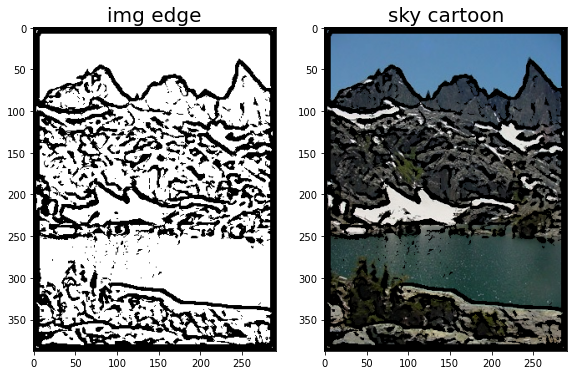

In [47]:
img_edge = CustomAdaptiveThreshold(img_blurr, 9,2)
images.append(img_edge)
titles.append('img edge')
img_edge = cv2.cvtColor(img_edge, cv2.COLOR_GRAY2RGB)
img_cartoon = cv2.bitwise_and(img, img_edge)
images.append(img_cartoon)
titles.append('sky cartoon')
display_img_arr(images, 1, 4, (20, 20),  titles)